In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from IPython.display import HTML
import matplotlib.animation as animation

<>:36: SyntaxWarning: invalid escape sequence '\P'
<>:36: SyntaxWarning: invalid escape sequence '\P'
/var/folders/3v/6kq_73ns7j57377v07xc6t_40000gn/T/ipykernel_13954/1875400162.py:36: SyntaxWarning: invalid escape sequence '\P'
  plt.ylabel('$\Psi$(x, t) (Amplitude)')
/var/folders/3v/6kq_73ns7j57377v07xc6t_40000gn/T/ipykernel_13954/1875400162.py:30: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap('coolwarm', M//20)


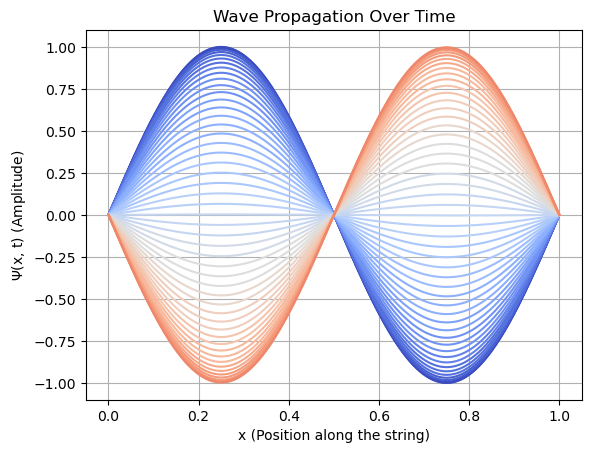

In [108]:
L = 1
N = 1000  
dx = L / (N - 1)
c = 1
dt = 0.001  
T = 0.5
M = int(T / dt)

x = np.linspace(0, L, N)
t = np.linspace(0, T, M)
u = np.zeros((N, M))

# Initial conditions
u[:, 0] = np.sin(2 * np.pi * x)
#u[:, 0] = np.sin(5 * np.pi * x)  # Condition (ii)
#u[:, 0] = np.where((x > 1/5) & (x < 2/5), np.sin(5 * np.pi * x), 0)


u[0, :] = 0
u[-1, :] = 0

for i in range(1, N-1):
    u[i, 1] = u[i, 0]

for j in range(1,M-1):
    for i in range(1,N-1):
        u[i,j+1]= c**2 * (dt**2/dx**2) * (u[i+1,j] + u[i-1,j] - 2* u[i,j]) - u[i,j-1] + 2*u[i,j]

# Every 20th timestep
cmap = cm.get_cmap('coolwarm', M//20)

for j in range(0, M, 10): 
    plt.plot(x, u[:, j],color=cmap(j // (M//20)))

plt.xlabel('x (Position along the string)')
plt.ylabel('$\Psi$(x, t) (Amplitude)')
plt.title('Wave Propagation Over Time')
#plt.legend()
plt.grid()
plt.show()

<>:7: SyntaxWarning: invalid escape sequence '\P'
<>:7: SyntaxWarning: invalid escape sequence '\P'
/var/folders/3v/6kq_73ns7j57377v07xc6t_40000gn/T/ipykernel_13954/1112197271.py:7: SyntaxWarning: invalid escape sequence '\P'
  ax.set_ylabel('$\Psi$(x, t) (Amplitude)')
Animation size has reached 21013722 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


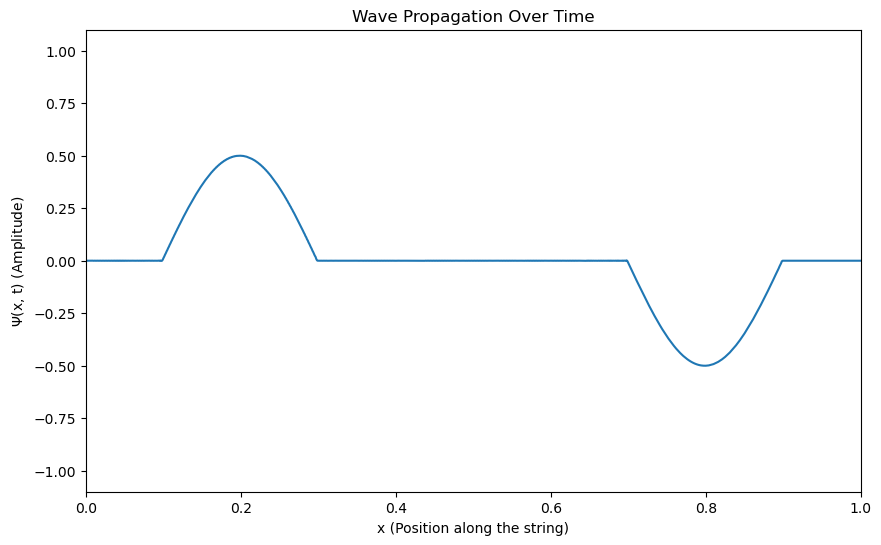

In [3]:
fig, ax = plt.subplots(figsize=(10, 6))
line, = ax.plot([], []) 

ax.set_xlim(0, L)
ax.set_ylim(-1.1, 1.1)
ax.set_xlabel('x (Position along the string)')
ax.set_ylabel('$\Psi$(x, t) (Amplitude)')
ax.set_title('Wave Propagation Over Time')

def update(frame):
    line.set_data(x, u[:, frame]) 
    return line,

ani = animation.FuncAnimation(fig, update, frames=M, interval=20, blit=True)
HTML(ani.to_jshtml())

### Question H 
H. (1 point) Implement the Jacobi iteration, the Gauss-Seidel method and SOR.
Try N = 50. Test the methods by comparing the result to the analytical result in
eq. (5), i.e. the linear dependence of the concentration on y


the jacobi iteration updates the concentration at each grid point based on the average of its four neighboring points. Iterate repeatedly until the solution stabilizes (i.e., the change between iterations is very small)

\textbf{Initialization:}

Set up an array $c_{current}[i, j]$ for the current iteration.  
Set up another array $c_{next}[i, j]$ for the next iteration.  
Apply boundary conditions immediately:  

\begin{equation}  
c[:, 0] = 0, \quad c[:, -1] = 1, \quad \text{periodic in } x  
\end{equation}  

Initial guess: Set the interior points to $0$ or some arbitrary value.  


For every point $(i, j)$ excluding boundaries, compute the new value using the formula:

\begin{equation}  
c\_next[i, j] = \frac{1}{4} \left( c\_current[i+1, j] + c\_current[i-1, j] + c\_current[i, j+1] + c\_current[i, j-1] \right)  
\end{equation}  

Do not update the values in $c_{current}$ immediately. Instead, store them in $c_{next}$.  
This is crucial because if you overwrite $c_{current}$ directly, you will lose information needed for the remaining calculations in this iteration.


Converged after 1036 iterations with delta = 9.997094325669975e-05


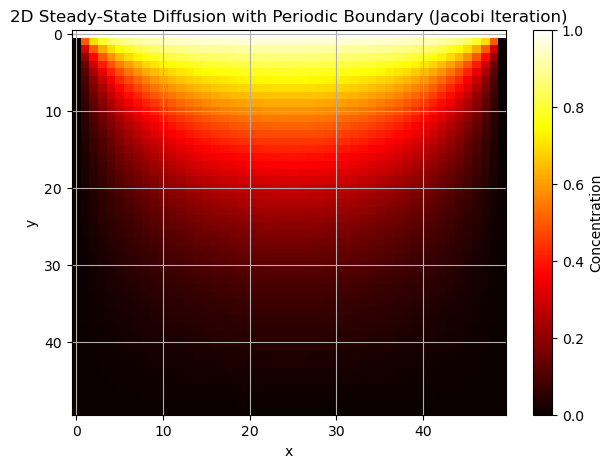

In [4]:
N = 50 
max_iter = 10000
epsilon = 10e-5

c_current = np.zeros((N,N))
c_next = np.zeros((N,N))
c_current[-1, :] = 0
c_current[0, :] = 1

iteration = 0
while iteration < max_iter:
    c_next = c_current.copy()
    for i in range(1,N-1):
        for j in range(1,N-1):
            
            c_next[i,j] = (1/4)*(c_current[(i+1)%N,j] + c_current[(i-1)%N,j] +c_current[i,j+1] +c_current[i,j-1])
    
    c_next[-1, :] = 0
    c_next[0, :] = 1

    delta = np.max(np.abs(c_next - c_current))
    if delta < epsilon:
        print(f"Converged after {iteration} iterations with delta = {delta}")
        break

    c_current[:, :] = c_next[:, :]
    iteration += 1

plt.figure(figsize=(7,5))
plt.imshow(c_current,  cmap='hot', aspect='auto')
plt.colorbar(label='Concentration')
plt.title('2D Steady-State Diffusion with Periodic Boundary (Jacobi Iteration)')
plt.xlabel('x')
plt.ylabel('y')
plt.grid(True)
plt.show()

Converged after 673 iterations with delta = 9.999983243991206e-05


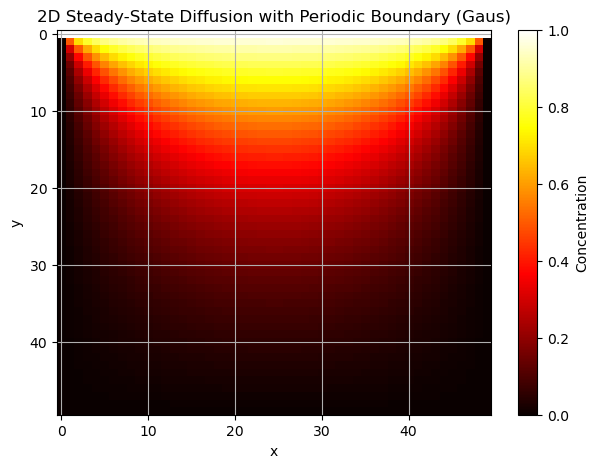

In [5]:
N = 50 
max_iter = 10000
epsilon = 10e-5

c_current = np.zeros((N,N))
c_next = np.zeros((N,N))
c_current[-1, :] = 0
c_current[0, :] = 1

iteration = 0
while iteration < max_iter:
    c_next = c_current.copy()
    for i in range(1,N-1):
        for j in range(1,N-1):
            
            c_next[i,j] = (1/4)*(c_current[(i+1)%N,j] + c_next[(i-1)%N,j] +c_current[i,j+1] +c_next[i,j-1])
    
    c_next[-1, :] = 0
    c_next[0, :] = 1

    delta = np.max(np.abs(c_next - c_current))
    if delta < epsilon:
        print(f"Converged after {iteration} iterations with delta = {delta}")
        break

    c_current[:, :] = c_next[:, :]
    iteration += 1

plt.figure(figsize=(7,5))
plt.imshow(c_current,  cmap='hot', aspect='auto')
plt.colorbar(label='Concentration')
plt.title('2D Steady-State Diffusion with Periodic Boundary (Gaus)')
plt.xlabel('x')
plt.ylabel('y')
plt.grid(True)
plt.show()

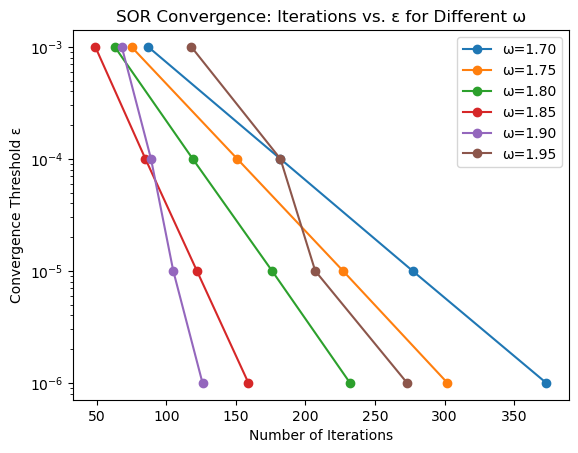

In [23]:
N = 50
max_iter = 10000
epsilon_list = [1e-3,1e-4, 1e-5,1e-6]  # Different convergence criteria
w_list = [1.7, 1.75, 1.8, 1.85, 1.9, 1.95]  # Relaxation factors

def SOR(w, epsilon):
    c_current = np.zeros((N, N))
    c_next = np.zeros((N, N))

    c_current[-1, :] = 0
    c_current[0, :] = 1  

    iteration = 0
    while iteration < max_iter:
        c_next = c_current.copy()  

        for i in range(1,N-1):
            for j in range(1,N-1):
                
                c_next[i,j] = (w/4)*(c_current[(i+1)%N,j] + c_next[(i-1)%N,j] +c_current[i,j+1] +c_next[i,j-1]) + (1-w)*c_current[i,j]

        c_next[-1, :] = 0
        c_next[0, :] = 1 

        delta = np.max(np.abs(c_next - c_current))
        if delta < epsilon:
            return iteration

        c_current[:, :] = c_next[:, :]
        iteration += 1
    return iteration

iterations_matrix = np.zeros((len(epsilon_list), len(w_list)))
for e_idx, e in enumerate(epsilon_list):
    for w_idx, w in enumerate(w_list):
        i = SOR(w, e)
        iterations_matrix[e_idx, w_idx] = i
    
for w_idx, w in enumerate(w_list):
    plt.plot( 
        iterations_matrix[:, w_idx], epsilon_list,
        marker='o', 
        label=f'ω={w:.2f}'
    )

#plt.xscale('log')  # Log scale for ε
plt.yscale('log')  # Log scale for iterations
plt.ylabel('Convergence Threshold ε')
plt.xlabel('Number of Iterations')
plt.title('SOR Convergence: Iterations vs. ε for Different ω')
plt.legend()
plt.show()

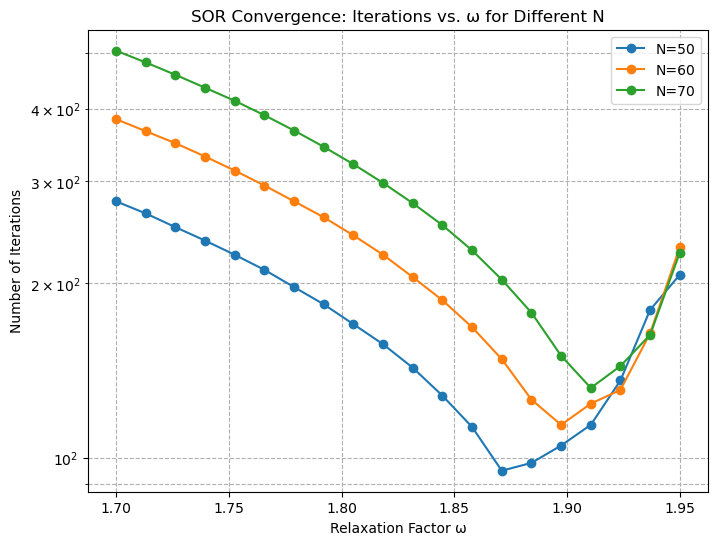

In [107]:
N_list = [50,60,70]
max_iter = 10000
epsilon_list = [1e-5] 
w_list = np.linspace(1.7,1.95,20)

def SOR(w, epsilon,N):
    c_current = np.zeros((N, N))
    c_next = np.zeros((N, N))

    c_current[-1, :] = 0
    c_current[0, :] = 1  

    iteration = 0
    while iteration < max_iter:
        c_next = c_current.copy()  

        for i in range(1,N-1):
            for j in range(1,N-1):
                
                c_next[i,j] = (w/4)*(c_current[(i+1)%N,j] + c_next[(i-1)%N,j] +c_current[i,j+1] +c_next[i,j-1]) + (1-w)*c_current[i,j]

        c_next[-1, :] = 0
        c_next[0, :] = 1 

        delta = np.max(np.abs(c_next - c_current))
        if delta < epsilon:
            return iteration

        c_current[:, :] = c_next[:, :]
        iteration += 1
    return iteration

iterations_matrix = np.zeros((len(N_list), len(w_list)))

for N_idx, N in enumerate(N_list):
    for w_idx, w in enumerate(w_list):
        i = SOR(w, epsilon, N)
        iterations_matrix[N_idx, w_idx] = i

plt.figure(figsize=(8, 6))

for N_idx, N in enumerate(N_list):
    plt.plot(
        w_list,
        iterations_matrix[N_idx, :],  # Iterations for each ω
        marker='o',
        label=f'N={N}'
    )
    print(np.min(iterations_matrix[N_idx, :])

plt.xscale('linear')
plt.yscale('log')  # Log scale for iterations
plt.xlabel('Relaxation Factor ω')
plt.ylabel('Number of Iterations')
plt.title('SOR Convergence: Iterations vs. ω for Different N')
plt.grid(True, which='both', linestyle='--')
plt.legend()
plt.show()

76


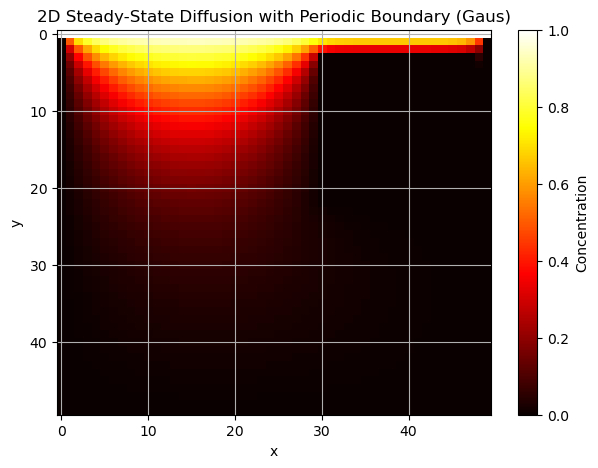

In [90]:
# list of points (i,j) that are part of object extra array of integers 1 for the object 
def object(N,size_rec, two_objects):
    grid = np.zeros((N,N))
    for i in range(size_rec):
        for j in range(size_rec -2):
            grid[i+ 3,j+30] = 1 
            if two_objects:
                grid[i+ 5,j+2] = 1
            
    return grid

N = 50
max_iter = 10000
epsilon = 1e-5
w = 1.85

def SOR_object(w, epsilon,N,number_objects,object_size):
    c_current = np.zeros((N, N))
    c_next = np.zeros((N, N))

    c_current[-1, :] = 0
    c_current[0, :] = 1  

    iteration = 0
    grid = object(N,object_size,number_objects)
    while iteration < max_iter:
        c_next = c_current.copy()  

        for i in range(1,N-1):
            for j in range(1,N-1):
                if grid[i,j]== 1:
                    c_next[i,j] == 0
                else:
                    c_next[i,j] = (w/4)*(c_current[(i+1)%N,j] + c_next[(i-1)%N,j] +c_current[i,j+1] +c_next[i,j-1]) + (1-w)*c_current[i,j]

        c_next[-1, :] = 0
        c_next[0, :] = 1 

        delta = np.max(np.abs(c_next - c_current))
        if delta < epsilon:
            return c_current, iteration

        c_current[:, :] = c_next[:, :]
        iteration += 1
    return c_current, iteration

i_list = []
c, i = SOR_object(w,epsilon,N, False,20)
print(i)
plt.figure(figsize=(7,5))
plt.imshow(c,  cmap='hot', aspect='auto')
plt.colorbar(label='Concentration')
plt.title('2D Steady-State Diffusion with Periodic Boundary (Gaus)')
plt.xlabel('x')
plt.ylabel('y')
plt.grid(True)
plt.show()

i_list_smallobject = []
i_list_bigobject = []
i_list_2smallobjects = []
i_list_2bigobjects = []
i_noobject = []
w_list = np.linspace(1.7,1.95,20)
for w in w_list:
    c, i_small = SOR_object(w,epsilon,N,False,5)
    c, i_big = SOR_object(w,epsilon,N,False,20)
    c, i_2small = SOR_object(w,epsilon,N,True,5)
    c, i_2big = SOR_object(w,epsilon,N,True,20)
    c,i_no =SOR_object(w,epsilon,N,True,0)
    i_list_smallobject.append(i_small)
    i_list_bigobject.append(i_big)
    i_list_2smallobjects.append(i_2small)
    i_list_2bigobjects.append(i_2big)
    i_noobject.append(i_no)

<>:9: SyntaxWarning: invalid escape sequence '\o'
<>:9: SyntaxWarning: invalid escape sequence '\o'
/var/folders/3v/6kq_73ns7j57377v07xc6t_40000gn/T/ipykernel_13954/2324231223.py:9: SyntaxWarning: invalid escape sequence '\o'
  plt.xlabel('Relax parameter $\omega$')


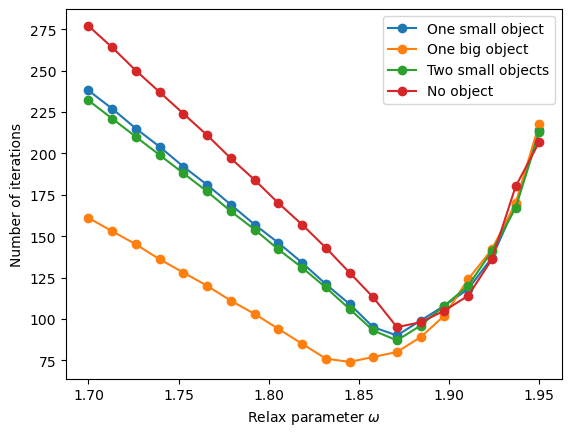

In [106]:
plt.plot(w_list,i_list_smallobject,marker='o',label = 'One small object')
plt.plot(w_list,i_list_bigobject,marker='o',label = 'One big object')
plt.plot(w_list,i_list_2smallobjects,marker='o',label = 'Two small objects')
#plt.plot(w_list,i_list_2bigobjects,label = 'Two big object')
plt.plot(w_list,i_noobject,marker='o',label = 'No object')
plt.legend()
#plt.yscale('log')
plt.ylabel('Number of iterations')
plt.xlabel('Relax parameter $\omega$')
plt.show()